## В данном задании мы будем сжимать звуковую дорожку при помощи алгоритма PCA

In [ ]:
# понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio

import numpy as np

from sklearn.decomposition import PCA

import matplotlib.pyplot as plt 

%matplotlib inline

In [ ]:
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2022-10-13 19:29:35--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6030:18::a27d:5012
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav [following]
--2022-10-13 19:29:35--  https://www.dropbox.com/s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uca86ee6f654c432bd94bff085f2.dl.dropboxusercontent.com/cd/0/inline/BuwBJqrSYoVhRYGvCBbcq1WW8Tad2Ls6hyOchGszeHtbBgCoiF8GAc3ON3zdU7x3NQKISfhBscHC3u-WYlEGRbcK72WP1A7pagAihPHonkPkZyZOV_mORMBr_vYYIRxG5SPVoTmt2Kmh6rxVAklFQmqnv_e1FMxF-45EhVdMD0mdMQ/file# [following]
--2022-10-13 19:29:35--  https://uca86ee6

In [ ]:
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

Выведем частоту дискретизации - она тут стандартная для аудио: 44100 Гц.

NOTE: **Частота дискретизации** говорит о том, сколько последовательных элементов массива с сигналом кодируют звук длительностью 1 секунда.

Подробнее о кодировании звука [тут](https://ru.wikipedia.org/wiki/Кодирование_звуковой_информации).

In [ ]:
print(samplerate)

44100


In [ ]:
data

array([[ 0,  0],
       [-1, -1],
       [-1, -1],
       ...,
       [ 0,  0],
       [ 0,  0],
       [ 0,  0]], dtype=int16)

In [ ]:
# Если поделить длину массива сигнала на samplerate, получится длительность аудиодорожки в секундах

print(len(data) / samplerate)

# 45 секунд - похоже на правду:)

45.139591836734695


In [ ]:
# Заметим, что звук - стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика):

print(data.shape)

(1990656, 2)


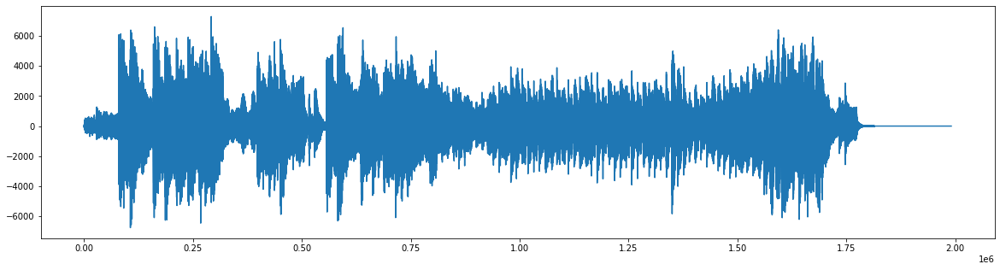

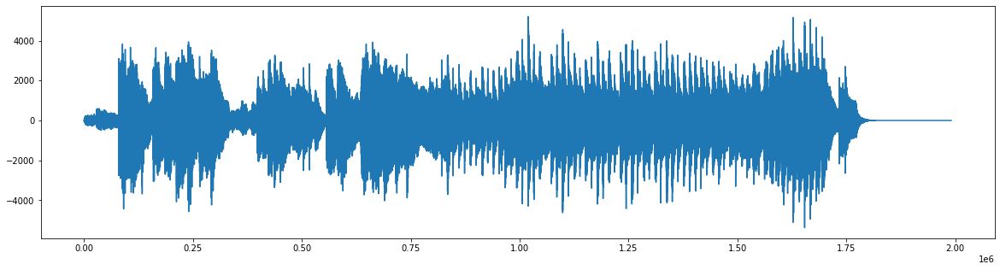

In [ ]:
# Отрисуем сигналы в обоих каналах

# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

In [ ]:
# Усредним каналы, и получим моно звук, с которым будет проще работать

mono_sound = np.mean(data, axis=1)
print(mono_sound.shape)

(1990656,)


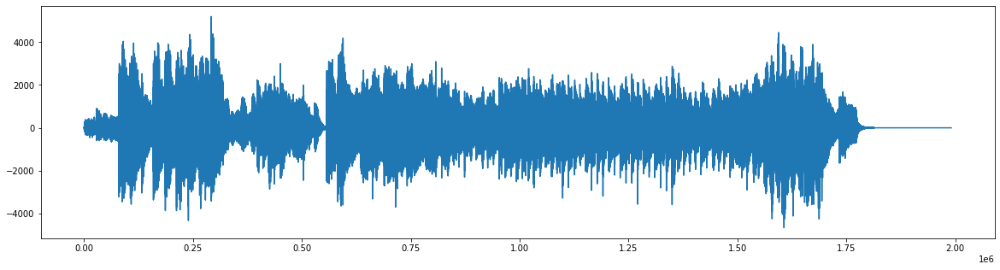

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(mono_sound)
plt.show()


In [ ]:
# Давайте послушаем наконец, что же мы будем сжимать:)

Audio(mono_sound, rate = samplerate)

In [ ]:
# Для удобства - обрежем массив с сигналом так, чтобы его было удобнее делить на равные части, 
# датасет из которых и необходимо будет сжать известными вам методами.
# На самом деле способ очень похож на тот, которым мы сжимали картинку, деля её на прямоугольные подкартинки)

mono_sound_to_cut = mono_sound[:1990000]

#### Задание 1:

1. Разделите сигнал на равные части (длину каждой части возьмите равной 1000).

2. Соберите из них "датасет", который будет представим в виде двуменого массива - "матрицы". (каждая часть длины 1000 -- одна строка)

3. Напишите функцию, которая будет переводить вашу "матрицу" обратно в звуковой сигнал. Проверьте что все работает, путем воспроизведения востановленного сигнала.

Подсказка: Вспомните про метод `.reshape()`

In [ ]:
# Ваше решение здесь
mono_sound_cuted = mono_sound_to_cut.reshape(-1,1000)
mono_sound_cuted.shape

(1990, 1000)

In [ ]:
mono_sound_restored_after_cuted = mono_sound_cuted.reshape((-1))
mono_sound_restored_after_cuted.shape

(1990000,)

In [ ]:
Audio(mono_sound_restored_after_cuted, rate = samplerate)

#### Задание 2

1. Выполните PCA преобразование, и получите данные, сжатые в пространство меньшей размерности  

2. Постройте сами две главные компоненты в наглядной форме. Сделайте выводы исходя из их вида.

3. Постройте scatter plot датасета в просрансве первых двух компонент, а третью используйте как цвет

Подсказка: код этого пункта практически полностью совпадает с кодом, который мы использовали на семинаре.

In [ ]:
# Ваше решение здесь

In [ ]:
pca = PCA(n_components=2)
sound_2D_compressed = pca.fit_transform(mono_sound_cuted)
sound_2D_decompressed = pca.inverse_transform(sound_2D_compressed)


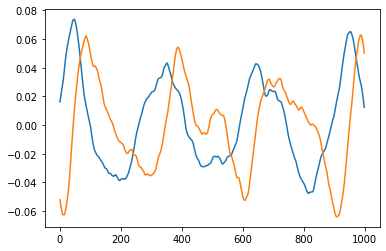

In [ ]:
plt.plot(pca.components_[0])

plt.plot(pca.components_[1])


Вывод: похожи на синусоиды

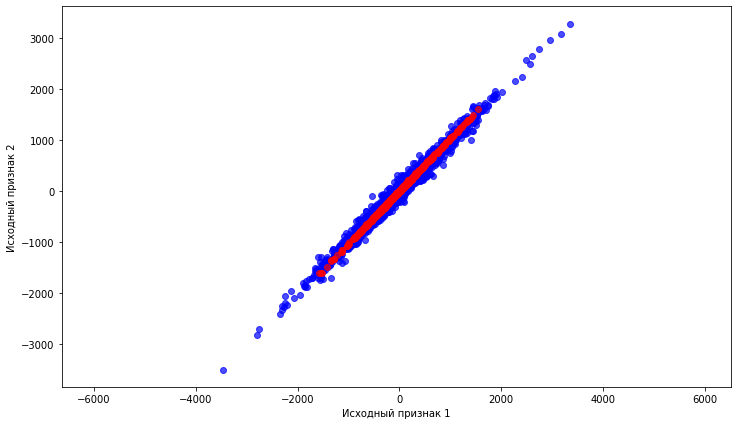

In [ ]:
X = mono_sound_cuted
X_hat = sound_2D_decompressed
Y = sound_2D_compressed

plt.figure(figsize=(12, 7))
plt.scatter(X[:, 0], X[:, 1], alpha=0.7, color='blue')
plt.scatter(X_hat[:, 0], X_hat[:, 1], color='red', alpha=0.7)
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.axis('equal')
plt.show()



#### Задание 3

1. Выполните обратное PCA преобразование сжатых данных и получите "матрицу" с сжатым звуком

2. Преобразуйте "матрицу" в сигнал (одномерный массив), и послушайте результат (Audio(YOUR_RESULT, rate = samplerate)

In [ ]:
# Ваше решение здесь

In [ ]:
sound_2D_decompressed.shape

(1990, 1000)

In [ ]:
sound_1D_decompressed = sound_2D_decompressed.reshape(-1)
sound_1D_decompressed.shape

(1990000,)

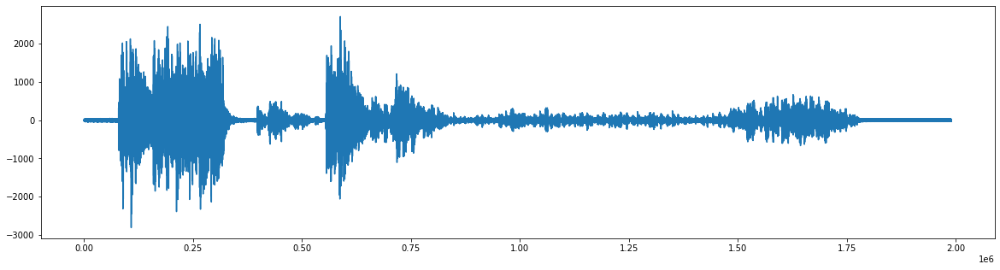

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(sound_1D_decompressed)
plt.show()

In [ ]:
Audio(sound_1D_decompressed, rate = samplerate)

In [ ]:
def try_pca_audio(n_components, mono_sound_cuted):
  pca = PCA(n_components=n_components)
  sound_2D_compressed = pca.fit_transform(mono_sound_cuted)
  sound_2D_decompressed = pca.inverse_transform(sound_2D_compressed)
  
  plt.plot(pca.components_[0])
  plt.plot(pca.components_[1])

  X = mono_sound_cuted
  X_hat = sound_2D_decompressed
  Y = sound_2D_compressed
  plt.figure(figsize=(12, 7))
  plt.scatter(X[:, 0], X[:, 1], alpha=0.7, color='blue')
  plt.scatter(X_hat[:, 0], X_hat[:, 1], color='red', alpha=0.7)
  plt.xlabel('Исходный признак 1')
  plt.ylabel('Исходный признак 2')
  plt.axis('equal')
  plt.show()

  sound_1D_decompressed = sound_2D_decompressed.reshape(-1) 
  plt.figure(figsize=(20,5))
  plt.plot(sound_1D_decompressed)
  plt.show()

  return sound_1D_decompressed




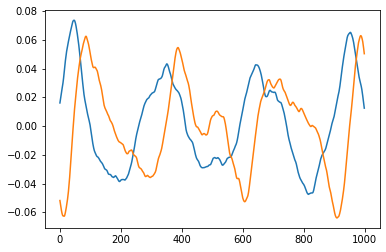

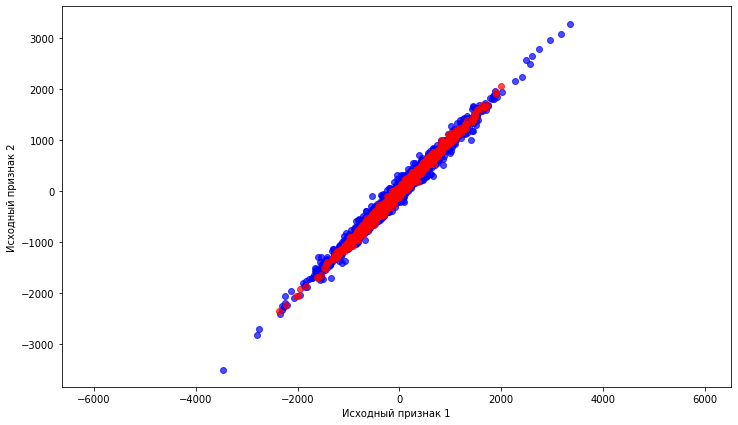

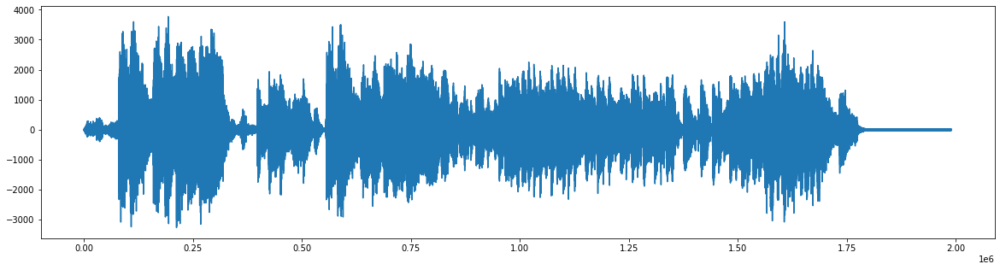

In [ ]:
sound_1D_decompressed = try_pca_audio(20, mono_sound_cuted)
Audio(sound_1D_decompressed, rate = samplerate)